![EncabezadoIN.JPG](attachment:EncabezadoIN.JPG)

# **Grupo**

- Juan David Anzola
- Mateo Anaya Romero
- Camilo Andres Morillo Cervantes

# Laboratorio1 BI, Regresión
Objetivos



---


* Construir modelos analíticos para estimar una variable objetivo continua a partir de un conjunto de variables observadas.

* Comprender el proceso para la construcción de modelos analíticos que responden a una tarea de regresión.

* Automatizar el proceso de construcción de modelos analíticos con el uso de pipelines de tal forma que puedan ser usados en ambientes de producción.

* Extraer información útil para el negocio a partir de los resultados de los modelos de regresión.

#Herramientas


---


Durante este laboratorio se trabajará con las siguientes herramientas:

* Librerías de Python para el procesamiento y analisis de datos como:
  * Pandas
  * Scikit-Learn
  * Matplotlib, Seaborn
  * NLTP


* Entorno de desarrollo Jupyter Lab instalado localmente mediante Anaconda o en la nube mediante Google Colab.

#Caso de negocio MediAlpes


---


MediAlpes es una EPS cuyo objetivo de negocio busca incorporar herramientas de Inteligencia Artificial para incrementar la eficiencia de la prestación de servicios a los usuarios en las diferentes IPS asociadas. En particular, MediAlpes ha dado luz verde a un proyecto que busca optimizar el proceso de admisión de pacientes en Urgencias.

Dicho proceso comienza con el triage, el cual, para cada paciente que ingresa a Urgencias, asigna un nivel de prioridad que permita a los especialistas médicos atender en primer lugar las condiciones de salud que pongan en riesgo la vida de las personas.

Actualmente, las IPS asociadas a MediAlpes emplean la escala de agudeza y triage coreanas (o KTAS, por su siglas en inglés), que consta de 5 niveles, siendo 1 el de mayor prioridad y 5 el de menor prioridad. La asignación de un nivel en el KTAS para un paciente es realizado por el personal médico a partir de una interpretación de síntomas y de signos vitales. (Para mayor información puede consultar este [artículo](https://academic.oup.com/intqhc/article/31/6/449/5079233)

La etapa inicial del proyecto tiene como objetivo la mejora de los procesos de asignación de recursos para la atención a pacientes que ingresen por Urgencias. En particular, MediAlpes quiere determinar si es posible estimar el tiempo aproximado de hospitalización de un paciente a partir de las condiciones de ingreso y mediciones de signos vitales realizadas desde el Triage en Urgencias. MediAlpes ha contratado a su equipo de Científicos de Datos para que evalúen la factibilidad de implementar un modelo de regresión capaz de responder a este requerimiento.

#1. Entendimiento del negocio

MediAlpes busca aumentar la eficiencia y efectividad en el manejo de pacientes en Urgencias, reduciendo tiempos de espera y optimizando el uso de recursos a través de la predicción del tiempo de hospitalización. El éxito del proyecto depende de la capacidad del modelo de IA para realizar predicciones precisas basadas en los datos disponibles en el momento del ingreso del paciente a Urgencias.

* Contexto de la Empresa:
  * MediAlpes es una EPS que busca mejorar la prestación de servicios en las IPS asociadas.
  * Se utilizan herramientas de IA para optimizar procesos, en particular el proceso de admisión de pacientes en Urgencias.

* Proceso de Triage Actual:

  * El proceso comienza con el triage, un sistema que asigna un nivel de prioridad a cada paciente.
  * MediAlpes utiliza la escala KTAS, que clasifica a los pacientes en 5 niveles de prioridad (de 1 a 5, siendo 1 el de mayor prioridad).
  * La clasificación actual es realizada por personal médico basado en la interpretación de síntomas y signos vitales.

* Objetivo del proyecto
  * MediAlpes quiere evaluar la posibilidad de estimar el tiempo de hospitalización de un paciente basándose en sus condiciones de ingreso y signos vitales recogidos durante el triage.
  * El objetivo es implementar un modelo de regresión que permita realizar estas estimaciones de manera precisa.

#Librerías Regresión

In [1]:
! pip install ydata_profiling >> /dev/null
! pip install joblib >> /dev/null

In [2]:
# Procesamiento y manipulación de datos
import pandas as pd
import numpy as np
import joblib

# Visualización de datos
import matplotlib.pyplot as plt
import seaborn as sns

# Modelado y evaluación de regresión
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder,RobustScaler, PowerTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import FunctionTransformer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from scipy import stats

#Librerías para el NLP

In [3]:
# Procesamiento de texto
import re
import string

# NLP y vectorización de texto
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import TruncatedSVD
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk import download

# Descargar recursos de NLTK (solo necesario una vez)
download('punkt')
download('stopwords')
download('wordnet')
# Opcional: Word embeddings
import gensim
from gensim.models import Word2Vec

# Opcional: Para ignorar advertencias
import warnings
warnings.filterwarnings('ignore')

# Configuración de visualización
sns.set(style='whitegrid')
plt.style.use('seaborn')

#Configuración de pandas
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 50)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


# Carga de datos train_data y validation_data

In [4]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

train_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/BI/labs/lab01/202420_Laboratorio 1 - Regresión_train_data.csv')
validation_data = pd.read_csv('/content/drive/My Drive/Colab Notebooks/BI/labs/lab01/202420_Laboratorio 1 - Regresión_validation_data.csv')


#train_data = pd.read_csv('202420_Laboratorio 1 - Regresión_train_data.csv')
#validation_data = pd.read_csv('202420_Laboratorio 1 - Regresión_validation_data.csv')

# train_data = pd.read_csv('/content/drive/My Drive/ColabNotebooks/BI/labs/lab01/train_data.csv')
# validation_data = pd.read_csv('/content/drive/My Drive/ColabNotebooks/BI/labs/lab01/validation_data.csv')

Mounted at /content/drive


In [5]:
train_data.head()

,Grupo,Sexo,Edad,Modo_Llegada,Lesion,Queja_Principal,Estado_Mental,Dolor,dolor_NRS,SBP,DBP,HR,RR,BT,Saturacion,KTAS_enfermera,Diagnostico_En_Urgencias,Disposicion,KTAS_experto,Grupo_De_Error,Duracion_Estancia_Min,Duracion_KTAS_Min,Error_Triaje
0,2,2,49,2,1,ant. chest pain,1,1,2,150.0,90.0,92.0,20.0,36.2,98.0,2,Ischaemic chest pain,2,2,0,1591,"2,00",0
1,2,2,30,4,1,headache,1,1,4,140.0,80.0,76.0,20.0,36.3,99.0,3,"Subarachnoid haemorrhage, unspecified",7,3,0,211,"3,00",0
2,2,1,61,3,2,ant. chest pain,1,1,3,100.0,60.0,84.0,20.0,36.4,98.0,4,Contusion of front wall of thorax,1,4,0,119,"2,00",0
3,2,2,61,3,1,headache,1,1,4,120.0,70.0,76.0,20.0,36.5,99.0,4,Headache,1,3,4,414,"2,00",2
4,1,2,67,3,1,fever & chill,1,0,#BOÞ!,143.0,70.0,130.0,20.0,38.1,NaN,4,Fever,1,2,1,267,"3,60",2


In [6]:
validation_data.head()

,Grupo,Sexo,Edad,Modo_Llegada,Lesion,Queja_Principal,Estado_Mental,Dolor,dolor_NRS,SBP,DBP,HR,RR,BT,Saturacion,Diagnostico_En_Urgencias,Disposicion,Grupo_De_Error,Duracion_KTAS_Min,Error_Triaje,KTAS_Enfermera,KTAS_Experto
0,2,1,41,3,2,Open Wound,1,1,3,120.0,80.0,74.0,20.0,36.3,98.0,"Superficial injury of face NOS, contusion",1,0,"4,00",0,3,3
1,1,1,63,2,1,arrest,4,0,#BOÞ!,NaN,NaN,NaN,NaN,NaN,NaN,Cardiac arrest,6,0,"5,42",0,1,1
2,2,2,76,2,1,dyspnea,1,1,3,110.0,70.0,61.0,20.0,36.4,98.0,"Heart failure, unspecified",2,0,"5,00",0,2,2
3,2,1,73,4,1,fever,1,0,#BOÞ!,100.0,60.0,70.0,20.0,37.4,98.0,"Fever, unspecified",1,0,"2,00",0,4,4
4,1,1,24,3,1,Near syncope,1,0,#BOÞ!,139.0,77.0,70.0,18.0,36.0,NaN,Syncope,1,0,"4,05",0,3,3


#2. Entendimiento de los datos.

## 2.1 Vista rápida de información acerca del dataset

In [7]:
train_data_copy = train_data.copy()
train_data.shape

(1000, 23)

In [8]:
train_data.describe()

,Grupo,Sexo,Edad,Modo_Llegada,Lesion,Estado_Mental,Dolor,SBP,DBP,HR,RR,BT,Saturacion,KTAS_enfermera,Disposicion,KTAS_experto,Grupo_De_Error,Duracion_Estancia_Min,Error_Triaje
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.0000,1000.000000,1000.000000,983.000000,979.000000,988.000000,985.000000,989.000000,444.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,1.450000,1.514000,53.892000,2.811000,1.2000,1.103000,0.562000,133.485249,79.566905,84.400810,19.450761,36.562993,97.047297,3.328000,1.610000,3.260000,0.569000,12792.480000,0.253000
std,0.497743,0.500054,19.826483,0.796186,0.4002,0.431946,0.496389,27.156136,15.174593,16.297428,2.069882,0.519699,4.761112,0.862067,1.161572,0.865534,1.587375,87721.151446,0.630387
min,1.000000,1.000000,16.000000,1.000000,1.0000,1.000000,0.000000,50.000000,31.000000,32.000000,14.000000,35.000000,20.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,36.000000,2.000000,1.0000,1.000000,0.000000,114.000000,70.000000,73.000000,18.000000,36.200000,97.000000,3.000000,1.000000,3.000000,0.000000,132.750000,0.000000
50%,1.000000,2.000000,56.000000,3.000000,1.0000,1.000000,1.000000,130.000000,80.000000,82.000000,20.000000,36.500000,98.000000,3.000000,1.000000,3.000000,0.000000,270.500000,0.000000
75%,2.000000,2.000000,70.250000,3.000000,1.0000,1.000000,1.000000,150.000000,90.000000,96.000000,20.000000,36.800000,99.000000,4.000000,2.000000,4.000000,0.000000,620.000000,0.000000
max,2.000000,2.000000,94.000000,7.000000,2.0000,4.000000,1.000000,275.000000,160.000000,148.000000,30.000000,39.800000,100.000000,5.000000,7.000000,5.000000,9.000000,709510.000000,2.000000


##2.2 Reporte completa del dataset usando ydata_profiling

In [9]:
import ydata_profiling

profile = ydata_profiling.ProfileReport(train_data)
profile.to_file('perfilado_datos.html')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

##Selección de features y variable objetivo

In [10]:
#Selección de variables objetivo y features
features = ["Grupo", "Sexo", "Edad", "Modo_Llegada", "Lesion", "Queja_Principal",
            "Estado_Mental", "Dolor", "dolor_NRS", "SBP", "DBP", "HR", "RR", "BT","Saturacion",
             "KTAS_enfermera", "Diagnostico_En_Urgencias", "Disposicion",
            "KTAS_experto", "Grupo_De_Error", "Duracion_KTAS_Min","Error_Triaje"]

target = "Duracion_Estancia_Min"  # O "Dolor_NRS" según el objetivo seleccionado

##2.3 Gráficos de puntos para buscar línealidad entre las características con la variable objetivo.



In [11]:
# Identificación de variables numéricas y categóricas
numeric_features = train_data.select_dtypes(include=["float64", "int64"]).columns
categorical_features = train_data.select_dtypes(include=["object"]).columns

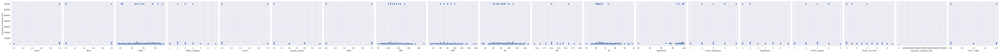

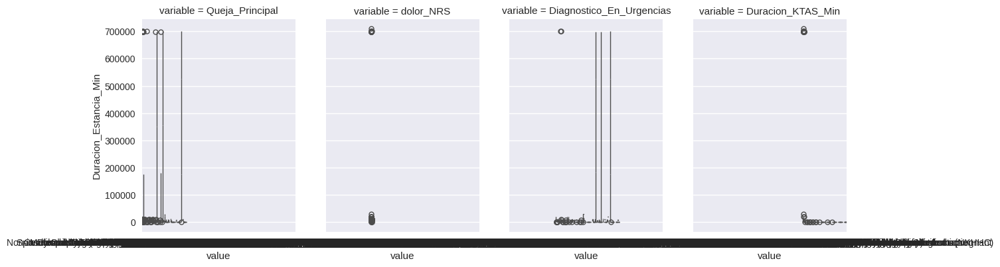

In [12]:
sns.pairplot(train_data, x_vars=numeric_features, y_vars=["Duracion_Estancia_Min"], height=4)
plt.show()

sns.catplot(data=train_data.melt(id_vars=["Duracion_Estancia_Min"], value_vars=categorical_features),
            x="value", y="Duracion_Estancia_Min", col="variable", kind="box", height=4, aspect=0.7)
plt.show()

##2.4 Mapa de calor para determinar la correlación entre variables númericas.

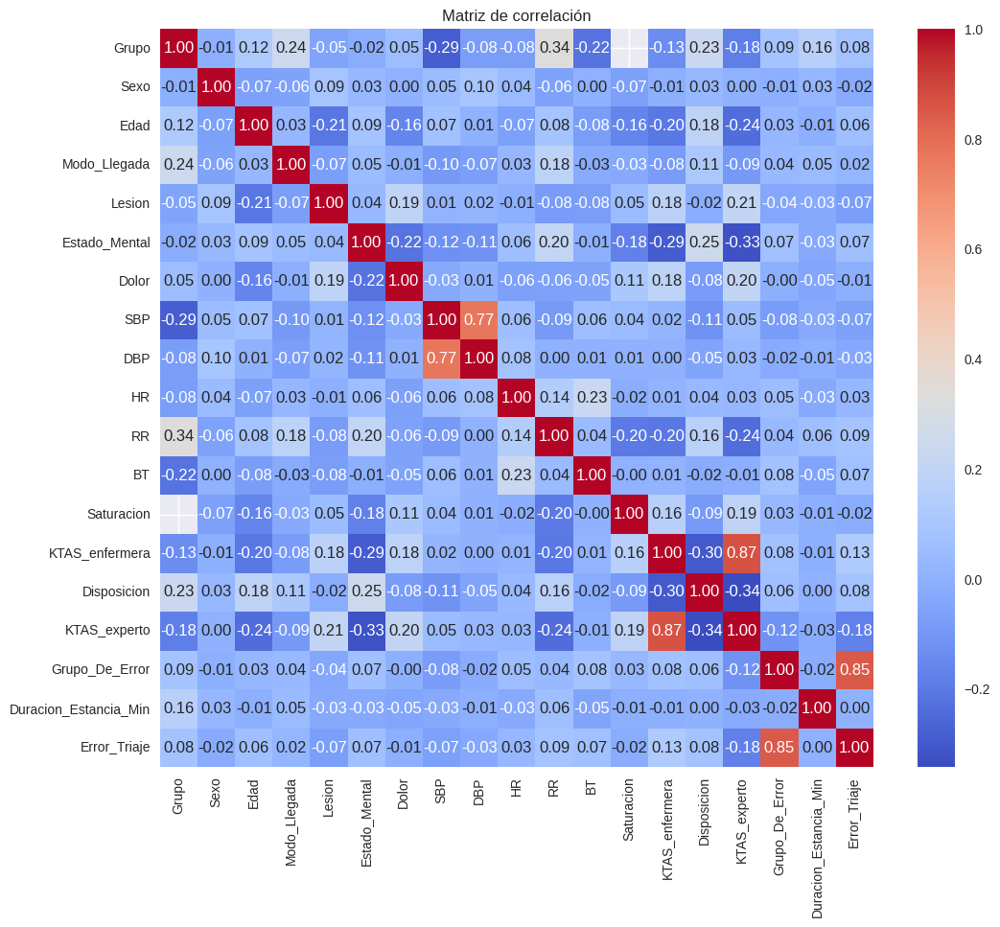

In [13]:
plt.figure(figsize=(12, 10))
sns.heatmap(train_data[numeric_features].corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Matriz de correlación")
plt.show()

##2.5 Distribución de las variables.

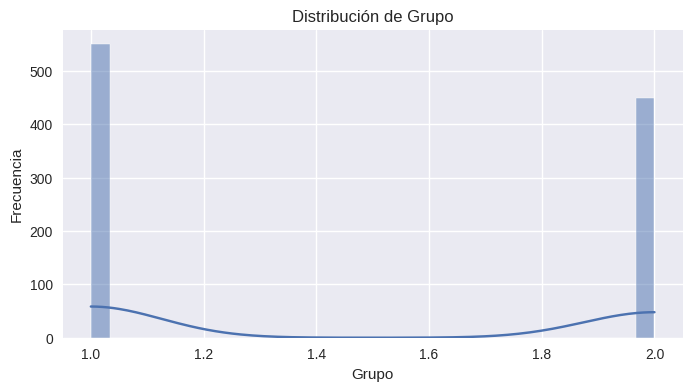

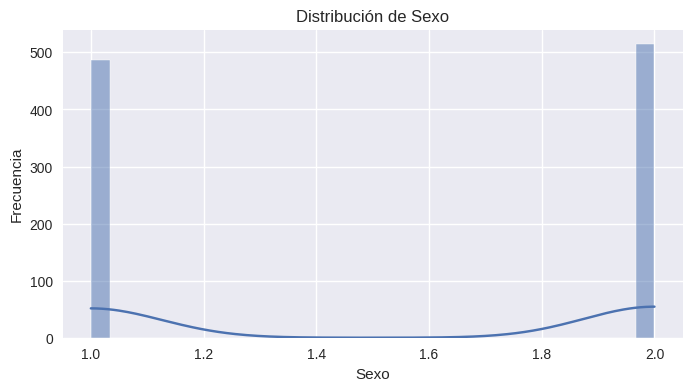

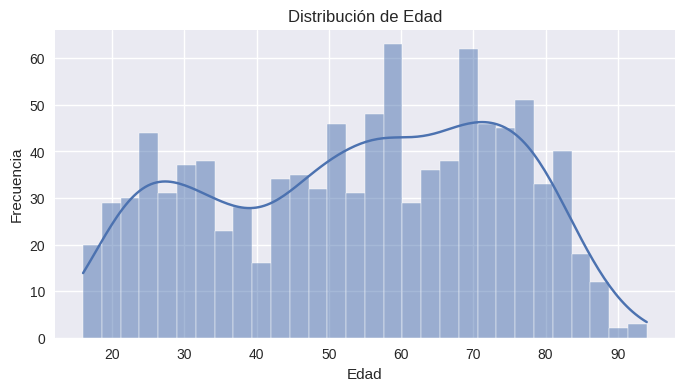

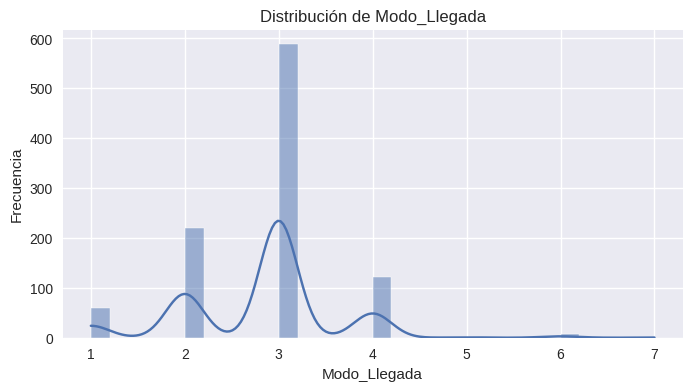

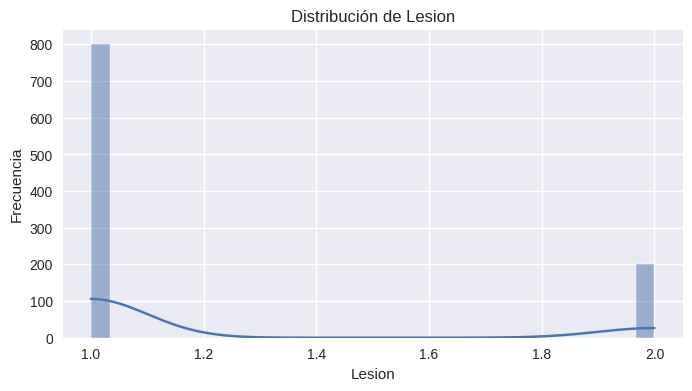

...

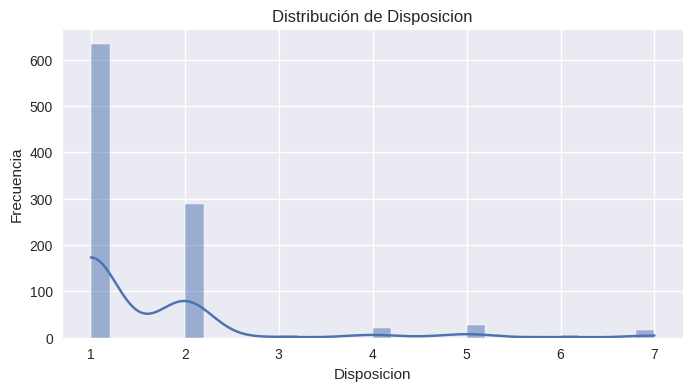

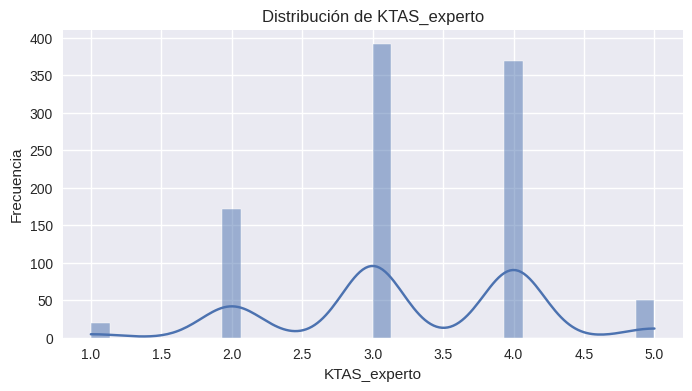

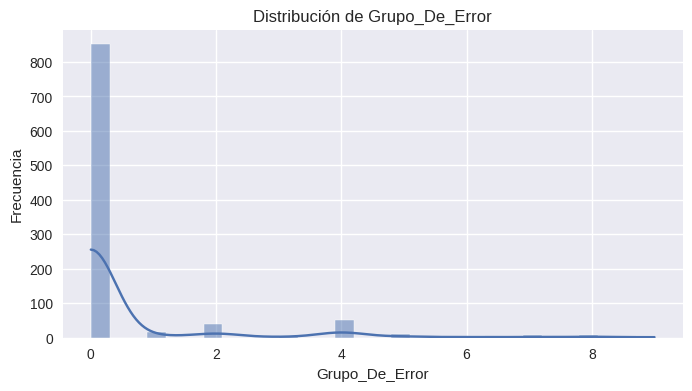

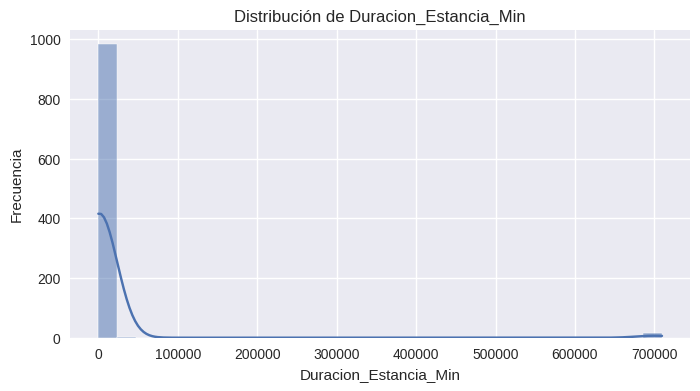

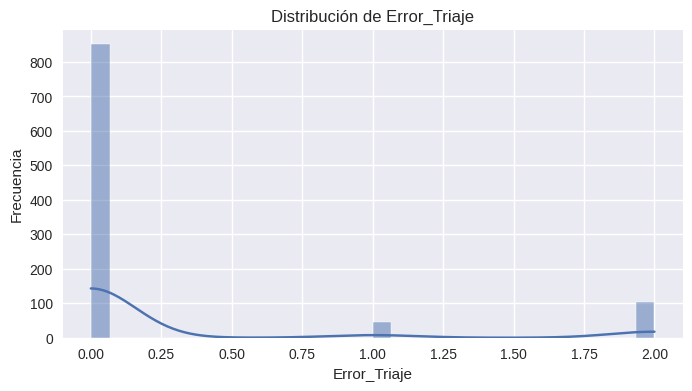

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns

# Selección de las variables numéricas
numeric_features = train_data.select_dtypes(include=["float64", "int64"]).columns

# Generar histogramas para cada variable numérica
for col in numeric_features:
    plt.figure(figsize=(8, 4))
    sns.histplot(train_data[col], kde=True, bins=30)
    plt.title(f'Distribución de {col}')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.show()

In [15]:
print(train_data[numeric_features].describe())

             Grupo         Sexo         Edad  Modo_Llegada     Lesion  \
count  1000.000000  1000.000000  1000.000000   1000.000000  1000.0000   
mean      1.450000     1.514000    53.892000      2.811000     1.2000   
std       0.497743     0.500054    19.826483      0.796186     0.4002   
min       1.000000     1.000000    16.000000      1.000000     1.0000   
25%       1.000000     1.000000    36.000000      2.000000     1.0000   
50%       1.000000     2.000000    56.000000      3.000000     1.0000   
75%       2.000000     2.000000    70.250000      3.000000     1.0000   
max       2.000000     2.000000    94.000000      7.000000     2.0000   

       Estado_Mental        Dolor         SBP         DBP          HR  \
count    1000.000000  1000.000000  983.000000  979.000000  988.000000   
mean        1.103000     0.562000  133.485249   79.566905   84.400810   
std         0.431946     0.496389   27.156136   15.174593   16.297428   
min         1.000000     0.000000   50.000000   31

#3. Pipeline Preparación

In [16]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Grupo                     1000 non-null   int64  
 1   Sexo                      1000 non-null   int64  
 2   Edad                      1000 non-null   int64  
 3   Modo_Llegada              1000 non-null   int64  
 4   Lesion                    1000 non-null   int64  
 5   Queja_Principal           1000 non-null   object 
 6   Estado_Mental             1000 non-null   int64  
 7   Dolor                     1000 non-null   int64  
 8   dolor_NRS                 1000 non-null   object 
 9   SBP                       983 non-null    float64
 10  DBP                       979 non-null    float64
 11  HR                        988 non-null    float64
 12  RR                        985 non-null    float64
 13  BT                        989 non-null    float64
 14  Saturacio

In [17]:
X = train_data.drop(columns=["Duracion_Estancia_Min", "Error_Triaje", "Grupo_De_Error"])
X['Queja_Principal'] = X['Queja_Principal'].fillna('')
X['Diagnostico_En_Urgencias'] = X['Diagnostico_En_Urgencias'].fillna('')
y = train_data["Duracion_Estancia_Min"]
y_transformed = np.log1p(y)




X_train, X_val, y_train, y_val = train_test_split(X, y_transformed, test_size=0.2, random_state=42)

X_test = validation_data.drop(columns=["Error_Triaje", "Grupo_De_Error"])
X_test.rename(columns={'KTAS_Experto': 'KTAS_experto', 'KTAS_Enfermera': 'KTAS_enfermera'}, inplace=True)
X_test['Queja_Principal'] = X_test['Queja_Principal'].fillna('')
X_test['Diagnostico_En_Urgencias'] = X_test['Diagnostico_En_Urgencias'].fillna('')
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 800 entries, 29 to 102
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Grupo                     800 non-null    int64  
 1   Sexo                      800 non-null    int64  
 2   Edad                      800 non-null    int64  
 3   Modo_Llegada              800 non-null    int64  
 4   Lesion                    800 non-null    int64  
 5   Queja_Principal           800 non-null    object 
 6   Estado_Mental             800 non-null    int64  
 7   Dolor                     800 non-null    int64  
 8   dolor_NRS                 800 non-null    object 
 9   SBP                       788 non-null    float64
 10  DBP                       784 non-null    float64
 11  HR                        790 non-null    float64
 12  RR                        786 non-null    float64
 13  BT                        790 non-null    float64
 14  Saturacion    

In [18]:
y_train.info()

<class 'pandas.core.series.Series'>
Index: 800 entries, 29 to 102
Series name: Duracion_Estancia_Min
Non-Null Count  Dtype  
--------------  -----  
800 non-null    float64
dtypes: float64(1)
memory usage: 12.5 KB


In [19]:
numerical_features = ['Edad', 'dolor_NRS', 'SBP', 'DBP', 'HR', 'RR', 'BT', 'Saturacion', 'Duracion_KTAS_Min']
categorical_features = ['Grupo','Sexo','Modo_Llegada', 'Lesion', 'Estado_Mental', 'Dolor', 'KTAS_enfermera', 'Disposicion', 'KTAS_experto']





# Custom transformer to convert non-numerical values to NaN
def convert_to_nan(X):
    return X.apply(pd.to_numeric, errors='coerce')



# Preprocessing for numerical data (Convert to NaN + Imputation )
numerical_transformer = Pipeline(steps=[

    ('convert_to_nan', FunctionTransformer(convert_to_nan)),
    ('imputer', SimpleImputer(strategy='median')),


])

# Preprocessing for categorical data (Imputation + OneHotEncoding)
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))
])


# Combine preprocessing for numerical, categorical, and text data
preprocessor = ColumnTransformer(transformers=[
    ('num', numerical_transformer, numerical_features),
    ('cat', categorical_transformer, categorical_features),
    ('tfidf_queja', TfidfVectorizer(), 'Queja_Principal'),
    ('tfidf_diagnostico', TfidfVectorizer(), 'Diagnostico_En_Urgencias'),
])

# Define the full pipeline with a regression model
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

#4. Creación del modelo

In [20]:


pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('convert_to_nan',
                                                                   FunctionTransformer(func=<function convert_to_nan at 0x7856cd8d2320>)),
                                                                  ('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['Edad', 'dolor_NRS', 'SBP',
                                                   'DBP', 'HR', 'RR', 'BT',
                                                   'Saturacion',
                                                   'Duracion_KTAS_Min']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['Grupo', 'Sexo',
                                                   'Modo_Llegada', 'Lesion',
                                                   'Estado_Mental', 'Dolor',
                                                   'KTAS_enfermera',
                                                   'Disposicion',
                                                   'KTAS_experto']),
                                                 ('tfidf_queja',
                                                  TfidfVectorizer(),
                                                  'Queja_Principal'),
                                                 ('tfidf_diagnostico',
                                                  TfidfVectorizer(),
                                                  'Diagnostico_En_Urgencias')])),
                ('regressor', LinearRegression())])

In [21]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 800 entries, 29 to 102
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Grupo                     800 non-null    int64  
 1   Sexo                      800 non-null    int64  
 2   Edad                      800 non-null    int64  
 3   Modo_Llegada              800 non-null    int64  
 4   Lesion                    800 non-null    int64  
 5   Queja_Principal           800 non-null    object 
 6   Estado_Mental             800 non-null    int64  
 7   Dolor                     800 non-null    int64  
 8   dolor_NRS                 800 non-null    object 
 9   SBP                       788 non-null    float64
 10  DBP                       784 non-null    float64
 11  HR                        790 non-null    float64
 12  RR                        786 non-null    float64
 13  BT                        790 non-null    float64
 14  Saturacion    

In [22]:
joblib.dump(pipeline, 'model_pipeline.joblib') # Generate Joblib of the pipeline

['model_pipeline.joblib']

In [23]:
validation_data['Duracion_Estancia_Min'] = np.maximum(pipeline.predict(X_test), 0)
validation_data.to_csv('predictions_file.csv', index=False)
validation_data

,Grupo,Sexo,Edad,Modo_Llegada,Lesion,Queja_Principal,Estado_Mental,Dolor,dolor_NRS,SBP,DBP,HR,RR,BT,Saturacion,Diagnostico_En_Urgencias,Disposicion,Grupo_De_Error,Duracion_KTAS_Min,Error_Triaje,KTAS_Enfermera,KTAS_Experto,Duracion_Estancia_Min
0,2,1,41,3,2,Open Wound,1,1,3,120.0,80.0,74.0,20.0,36.3,98.0,"Superficial injury of face NOS, contusion",1,0,"4,00",0,3,3,1.726469
1,1,1,63,2,1,arrest,4,0,#BOÞ!,NaN,NaN,NaN,NaN,NaN,NaN,Cardiac arrest,6,0,"5,42",0,1,1,0.000000
2,2,2,76,2,1,dyspnea,1,1,3,110.0,70.0,61.0,20.0,36.4,98.0,"Heart failure, unspecified",2,0,"5,00",0,2,2,8.515413
3,2,1,73,4,1,fever,1,0,#BOÞ!,100.0,60.0,70.0,20.0,37.4,98.0,"Fever, unspecified",1,0,"2,00",0,4,4,8.242452
4,1,1,24,3,1,Near syncope,1,0,#BOÞ!,139.0,77.0,70.0,18.0,36.0,NaN,Syncope,1,0,"4,05",0,3,3,6.000959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,2,2,62,3,1,dyspnea,1,1,3,110.0,70.0,67.0,20.0,36.0,96.0,"Atrial fibrillation and atrial flutter, unspec...",2,0,"4,00",0,2,2,7.228294
296,1,2,56,3,1,RLQ abd. pain,1,1,4,163.0,94.0,83.0,16.0,37.0,NaN,Acute appendicitis,5,0,"5,75",0,3,3,2.170019
297,2,2,48,2,1,right chest pain,1,1,5,120.0,80.0,64.0,20.0,36.3,99.0,Unstable angina,1,0,"4,00",0,2,2,5.558895
298,2,1,29,3,2,foreign body ingestion,1,1,6,140.0,100.0,84.0,20.0,36.5,NaN,Chronic sore throat,1,0,"5,00",0,3,3,11.023061


In [24]:
# Non negative data
y_pred = np.maximum(pipeline.predict(X_val), 0)

#5. Validación

##5.1 Validación cuantitativa

In [25]:
# Calculate R^2 score
r2 = r2_score(y_val, y_pred)
print(f'R^2 Score: {r2}')

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_val, y_pred)
print(f'Mean Absolute Error (MAE): {mae}')

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_val, y_pred)
print(f'Mean Squared Error (MSE): {mse}')

# Calculate Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)
print(f'Root Mean Squared Error (RMSE): {rmse}')

R^2 Score: -1.818840273198222
Mean Absolute Error (MAE): 2.250666176581588
Mean Squared Error (MSE): 12.188326495279625
Root Mean Squared Error (RMSE): 3.491178382048048


In [26]:
y_pred.shape



(200,)

In [27]:
y_val.shape

(200,)

In [28]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm, probplot

residuals = y_val - y_pred

In [29]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(pipeline, X_train, y_train, cv=5, scoring='r2')

print(f"Cross-Validation R^2 Scores: {scores}")
print(f"Mean R^2 Score: {scores.mean()}")
print(f"Standard Deviation of R^2 Scores: {scores.std()}")

Cross-Validation R^2 Scores: [-2.74886067 -5.54301465 -4.77544512 -1.45439842 -2.09746726]
Mean R^2 Score: -3.3238372229590794
Standard Deviation of R^2 Scores: 1.5723419929843683


#5. Presentación para MediAlpes

In [30]:
# Calculate R^2 score
r2 = r2_score(y_val, y_pred)
print(f'R^2 Score: {r2}')

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_val, y_pred)
print(f'Mean Absolute Error (MAE): {mae}')

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_val, y_pred)
print(f'Mean Squared Error (MSE): {mse}')

# Calculate Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)
print(f'Root Mean Squared Error (RMSE): {rmse}')


R^2 Score: -1.818840273198222
Mean Absolute Error (MAE): 2.250666176581588
Mean Squared Error (MSE): 12.188326495279625
Root Mean Squared Error (RMSE): 3.491178382048048


Gráfico de Dispersión de Predicciones vs Valores Reales:



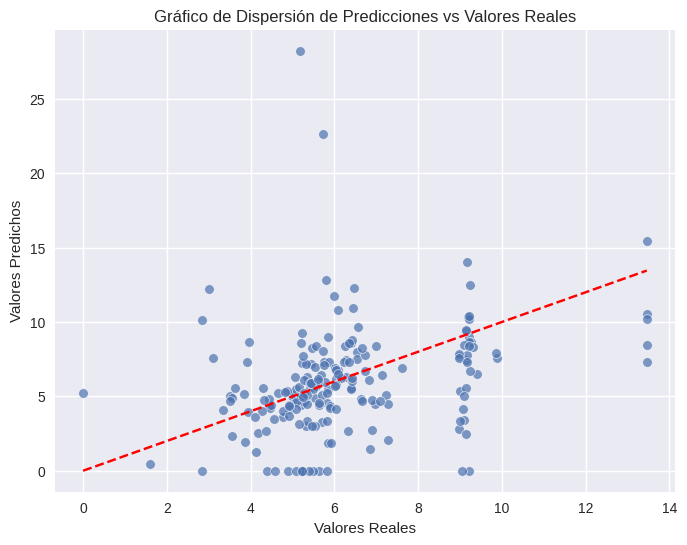

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_val, y=y_pred, alpha=0.7)

# Añadir una línea diagonal para referencia
plt.plot([min(y_val), max(y_val)], [min(y_val), max(y_val)], color='red', linestyle='--')

# Configurar etiquetas y título
plt.xlabel('Valores Reales')
plt.ylabel('Valores Predichos')
plt.title('Gráfico de Dispersión de Predicciones vs Valores Reales')

plt.show()

Gráfico de Residuos vs. Valores Predichos

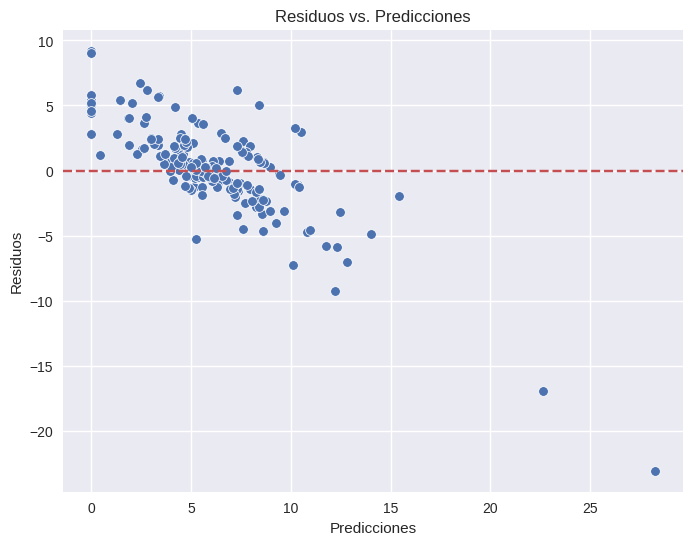

In [32]:
# Gráfico de Residuos vs. Predicciones
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_pred, y=residuals)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel('Predicciones')
plt.ylabel('Residuos')
plt.title('Residuos vs. Predicciones')
plt.show()


Gráfico Q-Q

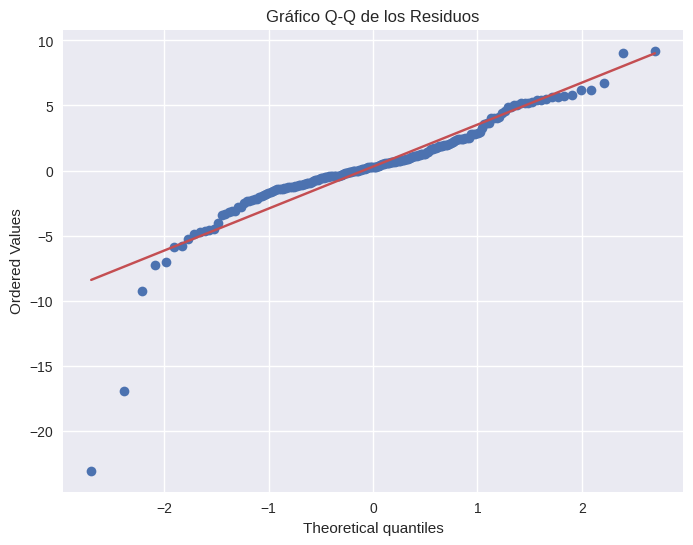

In [33]:
# Gráfico Q-Q
plt.figure(figsize=(8, 6))
probplot(residuals, dist="norm", plot=plt)
plt.title('Gráfico Q-Q de los Residuos')
plt.show()

Indica que hay desviaciones de la normalidad, pero estas no son extremadamente severas. Puede ser que los residuos sigan una distribución aproximadamente normal con algunas ligeras desviaciones.

Distribución del Error:

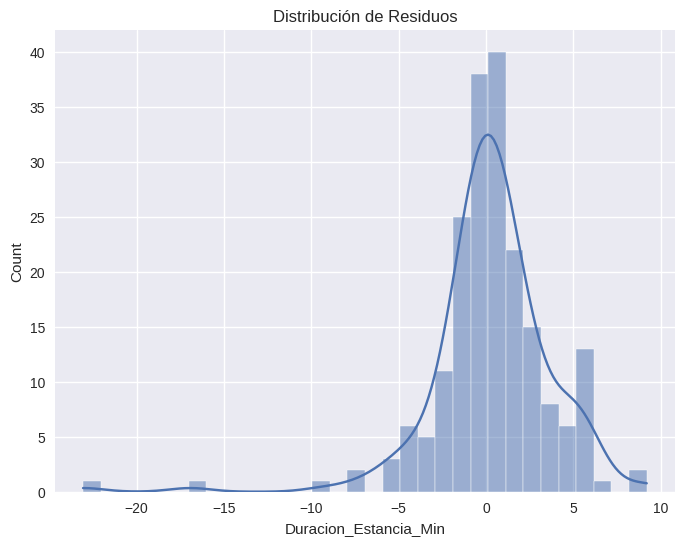

In [34]:
# Histograma de Residuos
plt.figure(figsize=(8, 6))
sns.histplot(residuals, kde=True)
plt.title('Distribución de Residuos')
plt.show()


Pruebas de Normalidad de Residuos

In [35]:
from scipy.stats import shapiro

# Prueba de Shapiro-Wilk
stat, p_value = shapiro(residuals)
print('Estadístico de Shapiro-Wilk:', stat)
print('Valor p de Shapiro-Wilk:', p_value)




Estadístico de Shapiro-Wilk: 0.8506873702372905
Valor p de Shapiro-Wilk: 4.644701666356281e-13


- Estadístico de Shapiro-Wilk (0.8507): Cuanto más cerca de 1 esté este valor, más cerca está la distribución de tus datos de una distribución normal.

- Valor p (4.6447e-13): Este valor p es extremadamente bajo (mucho menor que 0.05), lo que sugiere que hay evidencia suficiente para rechazar la hipótesis nula de que los datos siguen una distribución normal.

Medidas de Dispersión de Residuos

In [36]:

# Desviación estándar de los residuos
std_dev_residuals = np.std(residuals)
print('Desviación Estándar de los Residuos:', std_dev_residuals)

Desviación Estándar de los Residuos: 3.4777776500477433


##5.1 Conclusión

Dado que el objetivo de la empresa es mejorar el proceso de Urgencias reduciendo el tiempo de atención, se recomienda incluir variables adicionales que tengan una mayor relación con la duración en urgencias. Aunque el modelo actual logra estimar la duración del paciente en urgencias basándose en los datos entrenados, los resultados indican que las variables inicialmente consideradas no tienen una relación significativa con el tiempo de urgencia. Incorporar variables más relevantes podría mejorar la precisión del modelo y, en consecuencia, optimizar el tiempo de atención en urgencias.